# Tugas Analisis Multimedia: **Image (Citra Digital)**

**Mata Kuliah:** Sistem & Teknologi Multimedia  
**Nama:** M. Arief Rahman Hakim          
**NIM:** 122140083  

---

## Deskripsi Tugas

Tugas ini bertujuan untuk memahami **representasi dasar data citra digital (image)** melalui praktik langsung memuat data, visualisasi komponen warna, serta melakukan analisis spasial sederhana menggunakan berbagai teknik dasar pengolahan citra.

Anda akan bekerja dengan satu atau beberapa gambar (foto diri, objek, atau lingkungan sekitar) untuk:

* Mengamati struktur data piksel dan channel warna (RGB, Grayscale, HSV, dsb.)
* Menganalisis perbedaan hasil visualisasi antar representasi warna
* Melakukan eksplorasi sederhana terhadap transformasi citra (cropping, filtering, edge detection, dll.)
* Menyimpulkan pengaruh setiap tahap pemrosesan terhadap persepsi visual

Fokus tugas ini adalah pada **pemahaman konsep representasi spasial citra digital** dan **interpretasi hasil visualisasi**, **bukan** pada manipulasi kompleks atau penerapan model pembelajaran mesin.

### **Soal 1 — Cropping dan Konversi Warna**

* Ambil sebuah gambar diri Anda (*selfie*) menggunakan kamera atau smartphone.
* Lakukan **cropping secara manual** untuk menghasilkan dua potongan:

  * Cropping **kotak persegi pada area wajah**.
  * Cropping **persegi panjang pada area latar belakang**.
* Resize hasil crop menjadi **920×920 piksel**.
* Konversi gambar menjadi **grayscale** dan **HSV**, lalu tampilkan ketiganya berdampingan.
* Tambahkan **anotasi teks** berisi nama Anda di atas kepala pada gambar hasil crop.

  * Gaya teks (font, warna, posisi, ukuran, ketebalan) **dibebaskan**.
* Jelaskan efek **cropping** dan **perubahan warna** menggunakan **Markdown**.


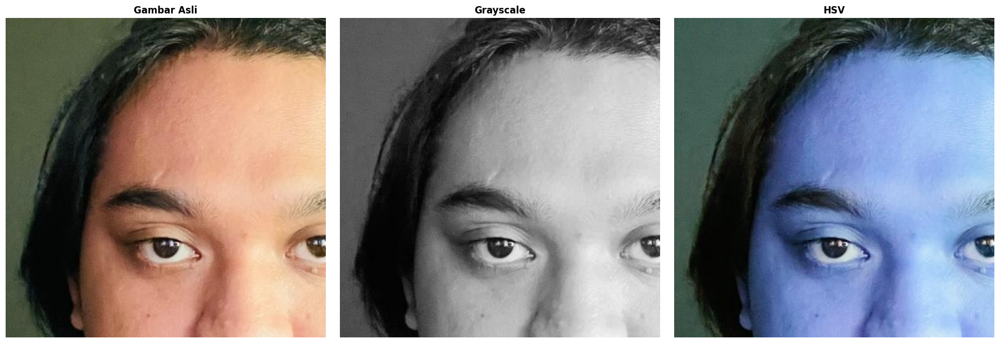

In [81]:
#Import gambar dari assets_ws4 mengunakan openCV gunain ost path join
import cv2
import os
from os import path
import numpy as np
import matplotlib.pyplot as plt

# Ambil gambar dari folder assets_ws4
image_path = path.join('assets_ws4', 'selfie.jpeg')

# Lakukan Cropping secara manual 
# Crop pertama cropping kotak persegi pada area wajah
img = cv2.imread(image_path)
img_cropped = img[400:800, 200:600]  # Adjust crop area lower
cv2.imwrite(path.join('results_ws4', 'selfie_cropped.jpeg'), img_cropped)
# Simpan hasil cropping
image_path_cropped = path.join('results_ws4', 'selfie_cropped.jpeg')

# Konversi menjadi grayscale dan HSV 
img = cv2.imread(image_path_cropped)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')
axes[1].imshow(img_gray, cmap='gray')
axes[1].set_title('Grayscale', fontsize=12, fontweight='bold')
axes[1].axis('off')
axes[2].imshow(cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB))
axes[2].set_title('HSV', fontsize=12, fontweight='bold')
axes[2].axis('off') 
plt.tight_layout()
plt.show()


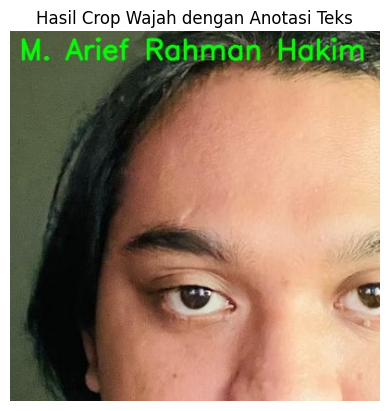

In [82]:
# Menambahkan anotasi teks pada gambar hasil crop wajah di bagian atas
font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(img_cropped, 'M. Arief Rahman Hakim', (10, 30), font, 1, (0, 255, 0), 2, cv2.LINE_AA)
cv2.imwrite(path.join('results_ws4', 'selfie_cropped.jpeg'), img_cropped)

# Tampilkan hasil cropping dengan anotasi teks
img = cv2.imread(image_path_cropped)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Hasil Crop Wajah dengan Anotasi Teks')
plt.show()

# Simpan hasil cropping dengan anotasi teks
image_path_cropped = path.join('results_ws4', 'selfie_cropped_annotated.jpeg')



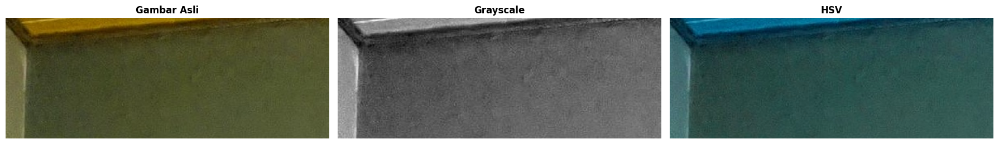

In [72]:
# Crop pertama cropping kotak persegi pada area latar belakang
img = cv2.imread(image_path)
img_cropped = img[50:200, 100:500]  # Adjust crop area lower
cv2.imwrite(path.join('results_ws4', 'selfie_cropped2.jpeg'), img_cropped)
# Simpan hasil cropping
image_path_cropped = path.join('results_ws4', 'selfie_cropped2.jpeg')

# Konversi menjadi grayscale dan HSV 
img = cv2.imread(image_path_cropped)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')
axes[1].imshow(img_gray, cmap='gray')
axes[1].set_title('Grayscale', fontsize=12, fontweight='bold')
axes[1].axis('off')
axes[2].imshow(cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB))
axes[2].set_title('HSV', fontsize=12, fontweight='bold')
axes[2].axis('off') 
plt.tight_layout()
plt.show()

**Cropping** mengambil region of interest (ROI) tertentu dari gambar dengan memotong array pixel berdasarkan koordinat `[y1:y2, x1:x2]`, sehingga ukuran data menjadi lebih kecil dan fokus pada area spesifik seperti wajah atau background—efeknya adalah mengurangi informasi visual yang tidak relevan dan mempercepat processing karena jumlah pixel berkurang. **Konversi warna** mengubah representasi ruang warna: **Grayscale** menyederhanakan 3 channel RGB menjadi 1 channel intensitas (0-255) dengan formula weighted average, menghasilkan gambar hitam-putih yang lebih ringan dan cocok untuk edge detection atau analisis tekstur; sedangkan **HSV** memisahkan komponen Hue (warna), Saturation (kejernihan), dan Value (kecerahan) yang lebih intuitif untuk manusia dan berguna dalam color-based segmentation—namun tampilan HSV di RGB colormap terlihat aneh karena perbedaan interpretasi channel (H tampak sebagai gradient warna, S sebagai intensitas putih-abu, V sebagai brightness).

### **Soal 2 — Manipulasi Channel Warna RGB**

* Gunakan gambar hasil crop dari Soal 1.
* Konversikan gambar ke ruang warna **RGB**.
* Lakukan manipulasi channel warna dengan cara:

  * **Naikkan intensitas channel merah sebanyak 50 poin** (maksimum 255).
  * **Turunkan intensitas channel biru sebanyak 30 poin** (minimum 0).
* Teknik atau cara menaikkan/menurunkan intensitas **dibebaskan**, asalkan logis dan hasilnya terlihat.
* Gabungkan kembali channel warna dan **simpan gambar hasil modifikasi dalam format `.png`**.
* **Tampilkan histogram per channel (R, G, B)** untuk gambar asli dan hasil modifikasi menggunakan `matplotlib.pyplot.hist`.
* Jelaskan dampak perubahan RGB pada warna gambar dalam sel **Markdown**.


=== Analisis Nilai RGB Gambar Asli ===
Ukuran gambar: (400, 400, 3)

Nilai RGB pada pixel tengah:
  Red (R)   : 205
  Green (G) : 145
  Blue (B)  : 121

=== Hasil Setelah Manipulasi ===

Gambar dengan Merah +50:
  Red (R)   : 255
  Green (G) : 145
  Blue (B)  : 121

Gambar dengan Biru -30:
  Red (R)   : 205
  Green (G) : 145
  Blue (B)  : 91


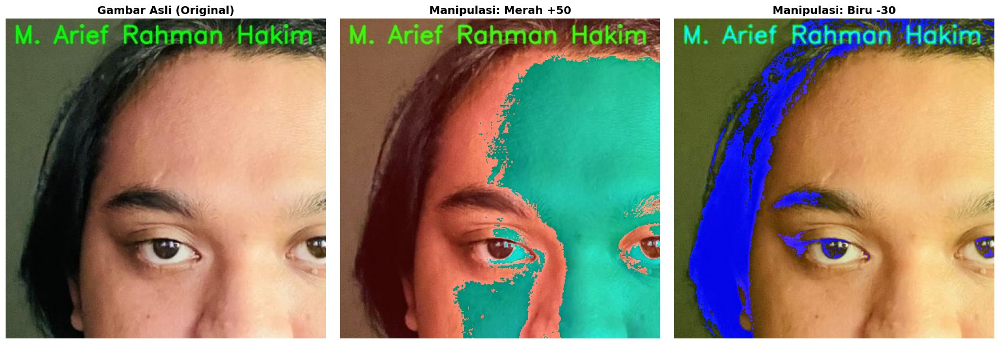

In [84]:
# Melakukan manipulasi channel warna rgb pada crop1
# Ambil gambar cropped di results_ws4
image_path_crop1 = path.join('results_ws4', 'selfie_cropped.jpeg')
crop1_bgr = cv2.imread(image_path_crop1)
crop1_rgb = cv2.cvtColor(crop1_bgr, cv2.COLOR_BGR2RGB)


# Cek nilai RGB channel pada beberapa pixel untuk referensi
print("=== Analisis Nilai RGB Gambar Asli ===")
print(f"Ukuran gambar: {crop1_rgb.shape}")
print(f"\nNilai RGB pada pixel tengah:")
center_y, center_x = crop1_rgb.shape[0]//2, crop1_rgb.shape[1]//2
print(f"  Red (R)   : {crop1_rgb[center_y, center_x, 0]}")
print(f"  Green (G) : {crop1_rgb[center_y, center_x, 1]}")
print(f"  Blue (B)  : {crop1_rgb[center_y, center_x, 2]}")

# Buat copy dari gambar asli untuk manipulasi
img_red = crop1_rgb.copy()
img_blue = crop1_rgb.copy()

# Manipulasi 1: Menaikkan intensitas channel merah sebanyak 50 poin
img_red[:,:,0] = np.clip(img_red[:,:,0] + 50, 0, 255)  # Channel Merah

# Manipulasi 2: Menurunkan intensitas channel biru sebanyak 30 poin
img_blue[:,:,2] = np.clip(img_blue[:,:,2] - 30, 0, 255)  # Channel Biru

# Verifikasi hasil manipulasi
print("\n=== Hasil Setelah Manipulasi ===")
print(f"\nGambar dengan Merah +50:")
print(f"  Red (R)   : {img_red[center_y, center_x, 0]}")
print(f"  Green (G) : {img_red[center_y, center_x, 1]}")
print(f"  Blue (B)  : {img_red[center_y, center_x, 2]}")

print(f"\nGambar dengan Biru -30:")
print(f"  Red (R)   : {img_blue[center_y, center_x, 0]}")
print(f"  Green (G) : {img_blue[center_y, center_x, 1]}")
print(f"  Blue (B)  : {img_blue[center_y, center_x, 2]}")
print("="*50)

# Tampilkan gambar asli, manipulasi merah, dan manipulasi biru
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].imshow(crop1_rgb)
axes[0].set_title('Gambar Asli (Original)', fontsize=14, fontweight='bold')
axes[0].axis('off')

axes[1].imshow(img_red)
axes[1].set_title('Manipulasi: Merah +50', fontsize=14, fontweight='bold')
axes[1].axis('off')

axes[2].imshow(img_blue)
axes[2].set_title('Manipulasi: Biru -30', fontsize=14, fontweight='bold')
axes[2].axis('off')

plt.tight_layout()
plt.show()

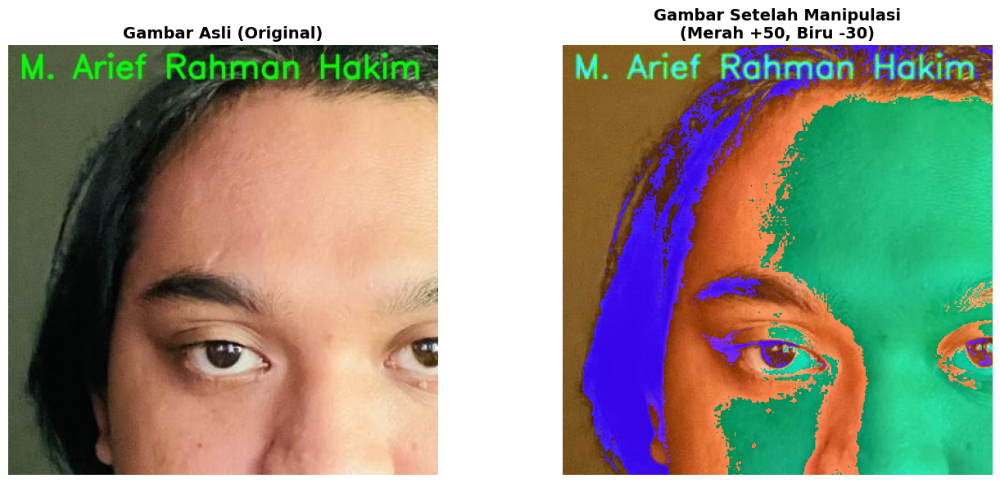

✓ Gambar hasil manipulasi gabungan berhasil disimpan di: c:\DATA\KULIYEAH\2025\Multimedia\Memo-Multimedia\results_ws4\manipulasi_crop1.png


In [85]:
# Menggabungkan kedua manipulasi channel warna (merah +50 dan biru -30)
manipulated_image = crop1_rgb.copy()
manipulated_image[:,:,0] = np.clip(manipulated_image[:,:,0] + 50, 0, 255)  # Channel Merah +50
manipulated_image[:,:,2] = np.clip(manipulated_image[:,:,2] - 30, 0, 255)  # Channel Biru -30

# Tampilkan gambar asli dan gambar setelah manipulasi channel warna
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

axes[0].imshow(crop1_rgb)
axes[0].set_title('Gambar Asli (Original)', fontsize=14, fontweight='bold')
axes[0].axis('off')

axes[1].imshow(manipulated_image)
axes[1].set_title('Gambar Setelah Manipulasi\n(Merah +50, Biru -30)', fontsize=14, fontweight='bold')
axes[1].axis('off')

plt.tight_layout()
plt.show()

# Simpan gambar hasil manipulasi gabungan ke folder results_ws4
output_dir = os.path.join(os.getcwd(), "results_ws4")
os.makedirs(output_dir, exist_ok=True)

# Convert RGB to BGR untuk disimpan dengan OpenCV
manipulated_bgr = cv2.cvtColor(manipulated_image, cv2.COLOR_RGB2BGR)
output_path = os.path.join(output_dir, "manipulasi_crop1.png")
cv2.imwrite(output_path, manipulated_bgr)

print(f"✓ Gambar hasil manipulasi gabungan berhasil disimpan di: {output_path}")

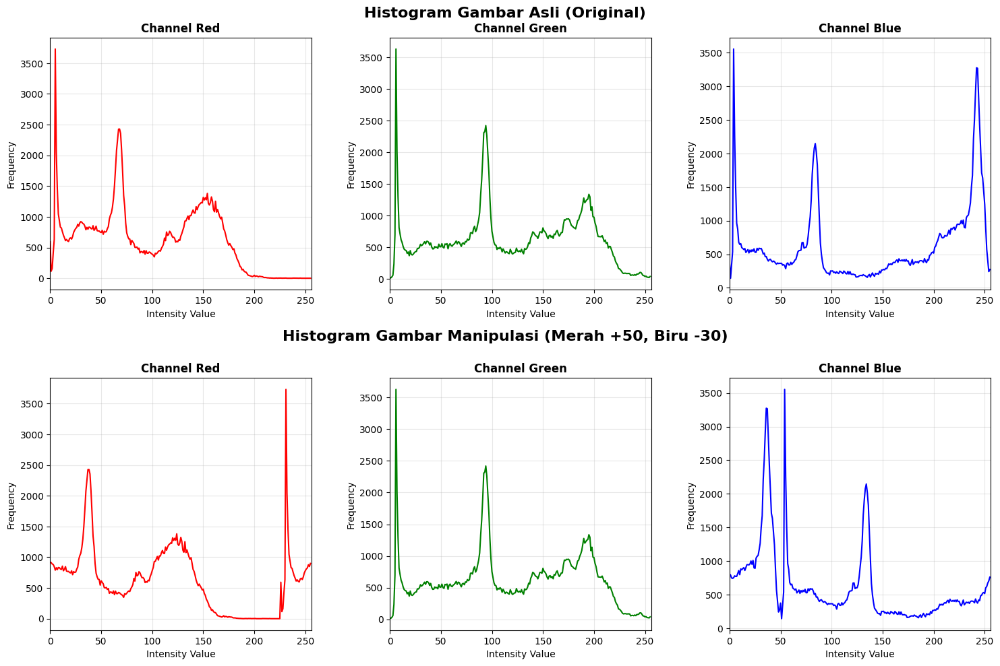

In [86]:
# Menampilkan histogram per channel untuk gambar asli dan hasil manipulasi
# Convert gambar ke format BGR untuk cv2.calcHist
crop1_bgr = cv2.cvtColor(crop1_rgb, cv2.COLOR_RGB2BGR)
manipulated_bgr_display = cv2.cvtColor(manipulated_image, cv2.COLOR_RGB2BGR)

# Buat subplot 2 baris x 3 kolom
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
colors = ('r', 'g', 'b')
channel_names = ('Red', 'Green', 'Blue')
bgr_colors = ('b', 'g', 'r')  # Urutan BGR untuk cv2.calcHist

# Baris 1: Histogram Gambar Asli
for i, (color, channel_name, bgr_color) in enumerate(zip(colors, channel_names, bgr_colors)):
    hist_original = cv2.calcHist([crop1_bgr], [i], None, [256], [0, 256])
    axes[0, i].plot(hist_original, color=color)
    axes[0, i].set_title(f'Channel {channel_name}', fontsize=12, fontweight='bold')
    axes[0, i].set_xlabel('Intensity Value')
    axes[0, i].set_ylabel('Frequency')
    axes[0, i].set_xlim([0, 256])
    axes[0, i].grid(alpha=0.3)

# Baris 2: Histogram Gambar Manipulasi
for i, (color, channel_name, bgr_color) in enumerate(zip(colors, channel_names, bgr_colors)):
    hist_manipulated = cv2.calcHist([manipulated_bgr_display], [i], None, [256], [0, 256])
    axes[1, i].plot(hist_manipulated, color=color)
    axes[1, i].set_title(f'Channel {channel_name}', fontsize=12, fontweight='bold')
    axes[1, i].set_xlabel('Intensity Value')
    axes[1, i].set_ylabel('Frequency')
    axes[1, i].set_xlim([0, 256])
    axes[1, i].grid(alpha=0.3)

# Tambahkan title untuk setiap baris
fig.text(0.5, 0.96, 'Histogram Gambar Asli (Original)', ha='center', fontsize=16, fontweight='bold')
fig.text(0.5, 0.48, 'Histogram Gambar Manipulasi (Merah +50, Biru -30)', ha='center', fontsize=16, fontweight='bold')

# Atur spacing
plt.subplots_adjust(top=0.93, bottom=0.05, hspace=0.35, wspace=0.3)
plt.show()

Manipulasi channel RGB mengubah komposisi warna gambar secara langsung: **menaikkan channel merah +50** membuat gambar tampak lebih kemerahan/warm tone karena dominasi intensitas merah bertambah (terlihat dari histogram merah yang bergeser ke kanan menuju nilai 255), sedangkan **menurunkan channel biru -30** mengurangi dominasi warna dingin sehingga gambar terlihat lebih kehijauan/kekuningan (histogram biru bergeser ke kiri menuju nilai 0). Kombinasi kedua manipulasi ini menghasilkan tone warna yang lebih hangat dengan nuansa oranye-kuning, cocok untuk efek sunset atau vintage—perubahan ini terlihat jelas pada histogram di mana distribusi pixel merah meningkat ke area terang (high intensity), sementara distribusi biru turun ke area gelap (low intensity), dan channel hijau tetap stabil sebagai baseline. Teknik ini sering digunakan dalam color grading untuk mengatur mood gambar tanpa mengubah struktur atau detail objek.

### **Soal 3 — Deteksi Tepi dan Filter Citra**

* Ambil gambar **objek dengan background bertekstur** (misalnya kain bermotif, jerami, atau batu).
* Terapkan **edge detection (Canny)** dan tampilkan hasilnya.
* Lakukan **thresholding dengan nilai ambang tertentu** (bebas Anda tentukan) agar hanya objek utama yang tersisa.
* Buat **bounding box** di sekitar objek hasil segmentasi (boleh manual atau otomatis).
* Terapkan **filter blur** dan **filter sharpening**, lalu **bandingkan hasil keduanya**.
* Jelaskan bagaimana setiap filter memengaruhi detail gambar dalam format **Markdown**.


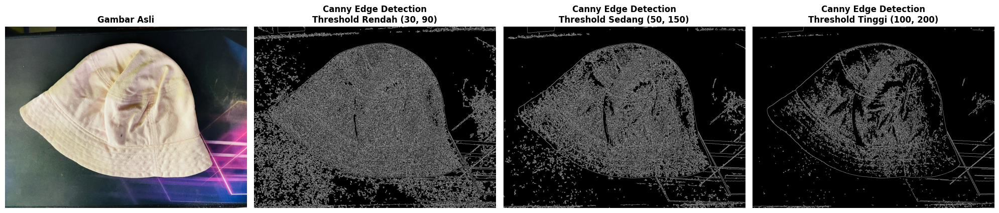

=== Informasi Edge Detection ===
Ukuran gambar: (960, 1280, 3)

Jumlah pixel tepi terdeteksi:
  Threshold Rendah (30, 90)  : 266457 pixel
  Threshold Sedang (50, 150) : 178412 pixel
  Threshold Tinggi (100, 200): 95987 pixel


In [41]:
# Mengambil gambar objek dari assets_ws4
img_path = os.path.join(os.getcwd(), "assets_ws4", "topi.jpeg")
img = cv2.imread(img_path)

# Konversi ke RGB untuk ditampilkan dengan benar di matplotlib
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Konversi ke grayscale untuk Canny edge detection
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Terapkan Canny Edge Detection dengan 3 threshold berbeda (tanpa blur)
# Threshold rendah (30, 90): Sensitif, mendeteksi banyak tepi termasuk noise
edges_low = cv2.Canny(img_gray, 30, 90)

# Threshold sedang (50, 150): Seimbang antara detail dan noise
edges_medium = cv2.Canny(img_gray, 50, 150)

# Threshold tinggi (100, 200): Ketat, hanya tepi kuat yang terdeteksi
edges_high = cv2.Canny(img_gray, 100, 200)

# Visualisasi dalam subplot 1 baris x 4 kolom
fig, axes = plt.subplots(1, 4, figsize=(20, 5))

# Gambar asli
axes[0].imshow(img_rgb)
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')

# Edge detection - Threshold rendah
axes[1].imshow(edges_low, cmap='gray')
axes[1].set_title('Canny Edge Detection\nThreshold Rendah (30, 90)', fontsize=12, fontweight='bold')
axes[1].axis('off')

# Edge detection - Threshold sedang
axes[2].imshow(edges_medium, cmap='gray')
axes[2].set_title('Canny Edge Detection\nThreshold Sedang (50, 150)', fontsize=12, fontweight='bold')
axes[2].axis('off')

# Edge detection - Threshold tinggi
axes[3].imshow(edges_high, cmap='gray')
axes[3].set_title('Canny Edge Detection\nThreshold Tinggi (100, 200)', fontsize=12, fontweight='bold')
axes[3].axis('off')

plt.tight_layout()
plt.show()

# Informasi tambahan
print("=== Informasi Edge Detection ===")
print(f"Ukuran gambar: {img.shape}")
print(f"\nJumlah pixel tepi terdeteksi:")
print(f"  Threshold Rendah (30, 90)  : {np.count_nonzero(edges_low)} pixel")
print(f"  Threshold Sedang (50, 150) : {np.count_nonzero(edges_medium)} pixel")
print(f"  Threshold Tinggi (100, 200): {np.count_nonzero(edges_high)} pixel")
print("="*50)

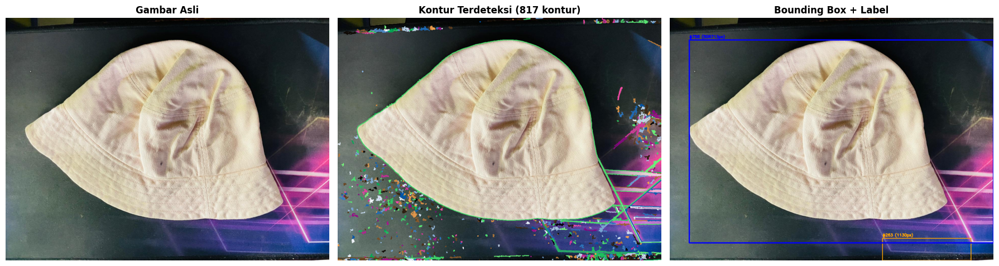

=== Informasi Deteksi Kontur ===
Total kontur terdeteksi: 817
Menggunakan edge: edges_medium (threshold 50, 150)

Top 5 kontur terbesar:
  #1: Area=506713px², Posisi=(77,87), Ukuran=1203x803
  #2: Area=1130px², Posisi=(841,872), Ukuran=350x88
  #3: Area=436px², Posisi=(1185,372), Ukuran=51x46
  #4: Area=231px², Posisi=(1137,412), Ukuran=80x60
  #5: Area=172px², Posisi=(1137,642), Ukuran=143x244


In [42]:
# Deteksi kontur menggunakan cv2.findContours
contours, hierarchy = cv2.findContours(edges_medium, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Gambar 1: Kontur dengan warna berbeda
img_contours = img.copy()
for idx, c in enumerate(contours):
    # Warna berbeda untuk tiap objek
    color = (
        int((idx * 50) % 255),
        int((idx * 100) % 255),
        int((idx * 150) % 255)
    )
    cv2.drawContours(img_contours, [c], -1, color, 2)

# Gambar 2: Bounding Box
img_boxes = img.copy()
for idx, c in enumerate(contours):
    # Hitung bounding box
    x, y, w, h = cv2.boundingRect(c)
    area = cv2.contourArea(c)
    
    # Filter kontur kecil (noise)
    if area < 500:
        continue
    
    # Warna berdasarkan ukuran
    if area > 5000:
        color = (255, 0, 0)  # Biru untuk objek besar
        thickness = 3
    elif area > 2000:
        color = (0, 255, 0)  # Hijau untuk objek sedang
        thickness = 2
    else:
        color = (0, 165, 255)  # Orange untuk objek kecil
        thickness = 2
    
    # Gambar rectangle
    cv2.rectangle(img_boxes, (x, y), (x + w, y + h), color, thickness)
    
    # Tambahkan label
    label = f"#{idx+1} ({area:.0f}px)"
    cv2.putText(img_boxes, label, (x, y-8), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

# Visualisasi hasil
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

axes[0].imshow(img_rgb)
axes[0].set_title("Gambar Asli", fontsize=12, fontweight='bold')
axes[0].axis("off")

axes[1].imshow(cv2.cvtColor(img_contours, cv2.COLOR_BGR2RGB))
axes[1].set_title(f"Kontur Terdeteksi ({len(contours)} kontur)", fontsize=12, fontweight='bold')
axes[1].axis("off")

axes[2].imshow(cv2.cvtColor(img_boxes, cv2.COLOR_BGR2RGB))
axes[2].set_title("Bounding Box + Label", fontsize=12, fontweight='bold')
axes[2].axis("off")

plt.tight_layout()
plt.show()

# Informasi kontur
print("=== Informasi Deteksi Kontur ===")
print(f"Total kontur terdeteksi: {len(contours)}")
print(f"Menggunakan edge: edges_medium (threshold 50, 150)")
print(f"\nTop 5 kontur terbesar:")
sorted_contours = sorted(contours, key=cv2.contourArea, reverse=True)[:5]
for idx, c in enumerate(sorted_contours):
    area = cv2.contourArea(c)
    x, y, w, h = cv2.boundingRect(c)
    print(f"  #{idx+1}: Area={area:.0f}px², Posisi=({x},{y}), Ukuran={w}x{h}")
print("="*50)

=== Tahap 1: Filter Blur ===
Ukuran gambar: (960, 1280, 3)
Kernel Gaussian Blur: (5, 5)
Sigma: 0 (auto)

=== Tahap 2: Canny Edge Detection (dengan Blur) ===
Jumlah pixel tepi terdeteksi:
  Threshold Rendah (30, 90)  : 58785 pixel
  Threshold Sedang (50, 150) : 17140 pixel
  Threshold Tinggi (100, 200): 7932 pixel

=== Tahap 3: Deteksi Kontur ===
Total kontur terdeteksi: 82
Kontur setelah filter (area > 10000px²): 1
Kontur TOPI terpilih: 1

📦 Detail Objek TOPI:
  Area           : 500544 px²
  Posisi (x,y)   : (77, 87)
  Ukuran (w×h)   : 1055 × 716 px
  Keliling       : 3759 px
  Aspect Ratio   : 1.47


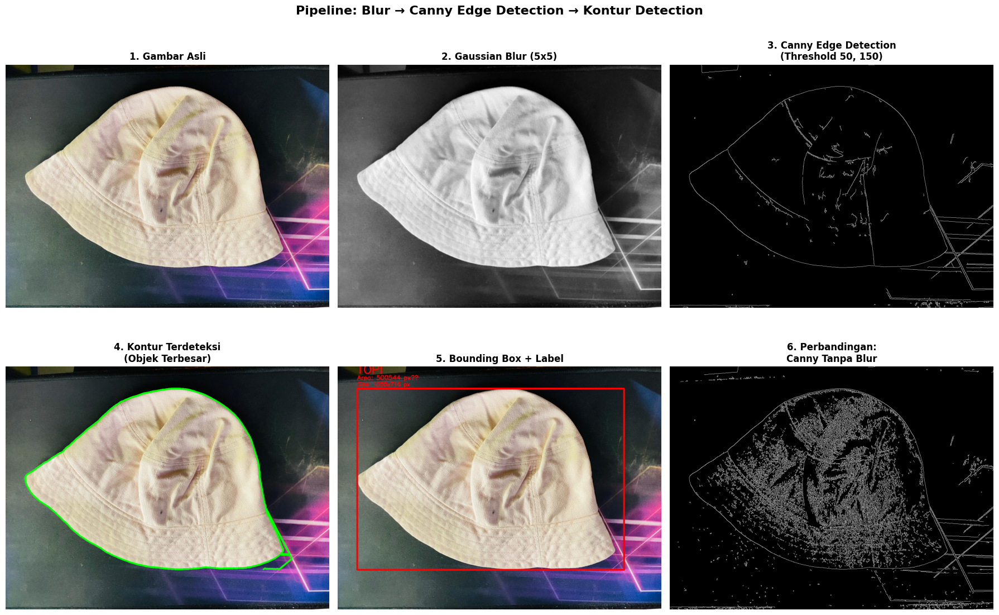


=== Perbandingan: Dengan Blur vs Tanpa Blur ===
Canny DENGAN Blur (50,150)  : 17140 pixel
Canny TANPA Blur (50,150)   : 95987 pixel
Selisih                     : 78847 pixel


In [46]:
# ========================================
# FILTER BLUR + CANNY EDGE DETECTION + DETEKSI KONTUR
# ========================================

# Mengambil gambar objek dari assets_ws4
img_path = os.path.join(os.getcwd(), "assets_ws4", "topi.jpeg")
img = cv2.imread(img_path)

# Konversi ke RGB untuk ditampilkan dengan benar di matplotlib
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Konversi ke grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# ========================================
# 1. TERAPKAN FILTER BLUR (Gaussian Blur)
# ========================================
# Kernel size (5,5) untuk smoothing sedang
img_blur = cv2.GaussianBlur(img_gray, (5, 5), 0)

print("=== Tahap 1: Filter Blur ===")
print(f"Ukuran gambar: {img.shape}")
print(f"Kernel Gaussian Blur: (5, 5)")
print(f"Sigma: 0 (auto)")

# ========================================
# 2. CANNY EDGE DETECTION (dengan blur)
# ========================================
# Threshold rendah (30, 90)
edges_blur_low = cv2.Canny(img_blur, 30, 90)

# Threshold sedang (50, 150)
edges_blur_medium = cv2.Canny(img_blur, 50, 150)

# Threshold tinggi (100, 200)
edges_blur_high = cv2.Canny(img_blur, 100, 200)

print("\n=== Tahap 2: Canny Edge Detection (dengan Blur) ===")
print(f"Jumlah pixel tepi terdeteksi:")
print(f"  Threshold Rendah (30, 90)  : {np.count_nonzero(edges_blur_low)} pixel")
print(f"  Threshold Sedang (50, 150) : {np.count_nonzero(edges_blur_medium)} pixel")
print(f"  Threshold Tinggi (100, 200): {np.count_nonzero(edges_blur_high)} pixel")

# ========================================
# 3. DETEKSI KONTUR (menggunakan threshold sedang)
# ========================================
contours_blur, hierarchy_blur = cv2.findContours(edges_blur_medium, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter kontur dengan area minimum
min_area = 10000
filtered_contours_blur = [c for c in contours_blur if cv2.contourArea(c) > min_area]

# Ambil hanya kontur terbesar (TOPI)
if len(filtered_contours_blur) > 0:
    largest_contour_blur = max(filtered_contours_blur, key=cv2.contourArea)
    topi_contours_blur = [largest_contour_blur]
else:
    topi_contours_blur = []

print("\n=== Tahap 3: Deteksi Kontur ===")
print(f"Total kontur terdeteksi: {len(contours_blur)}")
print(f"Kontur setelah filter (area > {min_area}px²): {len(filtered_contours_blur)}")
print(f"Kontur TOPI terpilih: {len(topi_contours_blur)}")

# Gambar kontur dan bounding box
img_contours_blur = img.copy()
img_boxes_blur = img.copy()

if len(topi_contours_blur) > 0:
    # Gambar kontur (hijau)
    cv2.drawContours(img_contours_blur, topi_contours_blur, -1, (0, 255, 0), 5)
    
    # Gambar bounding box (merah)
    c = topi_contours_blur[0]
    x, y, w, h = cv2.boundingRect(c)
    area = cv2.contourArea(c)
    
    color = (0, 0, 255)  # Merah
    thickness = 6
    
    cv2.rectangle(img_boxes_blur, (x, y), (x + w, y + h), color, thickness)
    
    # Tambahkan label
    cv2.putText(img_boxes_blur, "TOPI", (x, y-60), 
                cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 4)
    cv2.putText(img_boxes_blur, f"Area: {area:.0f} px²", (x, y-35), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2)
    cv2.putText(img_boxes_blur, f"Size: {w}x{h} px", (x, y-10), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)
    
    print(f"\n📦 Detail Objek TOPI:")
    print(f"  Area           : {area:.0f} px²")
    print(f"  Posisi (x,y)   : ({x}, {y})")
    print(f"  Ukuran (w×h)   : {w} × {h} px")
    perimeter = cv2.arcLength(c, True)
    print(f"  Keliling       : {perimeter:.0f} px")
    print(f"  Aspect Ratio   : {w/h:.2f}")

print("="*50)

# ========================================
# VISUALISASI HASIL (2 baris x 3 kolom)
# ========================================
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Baris 1: Tahap Preprocessing
axes[0, 0].imshow(img_rgb)
axes[0, 0].set_title('1. Gambar Asli', fontsize=12, fontweight='bold')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_blur, cmap='gray')
axes[0, 1].set_title('2. Gaussian Blur (5x5)', fontsize=12, fontweight='bold')
axes[0, 1].axis('off')

axes[0, 2].imshow(edges_blur_medium, cmap='gray')
axes[0, 2].set_title('3. Canny Edge Detection\n(Threshold 50, 150)', fontsize=12, fontweight='bold')
axes[0, 2].axis('off')

# Baris 2: Hasil Deteksi Kontur
axes[1, 0].imshow(cv2.cvtColor(img_contours_blur, cv2.COLOR_BGR2RGB))
axes[1, 0].set_title('4. Kontur Terdeteksi\n(Objek Terbesar)', fontsize=12, fontweight='bold')
axes[1, 0].axis('off')

axes[1, 1].imshow(cv2.cvtColor(img_boxes_blur, cv2.COLOR_BGR2RGB))
axes[1, 1].set_title('5. Bounding Box + Label', fontsize=12, fontweight='bold')
axes[1, 1].axis('off')

# Perbandingan: Tanpa Blur vs Dengan Blur
edges_no_blur = cv2.Canny(img_gray, 100, 200)
axes[1, 2].imshow(edges_no_blur, cmap='gray')
axes[1, 2].set_title('6. Perbandingan:\nCanny Tanpa Blur', fontsize=12, fontweight='bold')
axes[1, 2].axis('off')

plt.suptitle('Pipeline: Blur → Canny Edge Detection → Kontur Detection', 
             fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# Perbandingan jumlah pixel edge
print("\n=== Perbandingan: Dengan Blur vs Tanpa Blur ===")
print(f"Canny DENGAN Blur (50,150)  : {np.count_nonzero(edges_blur_medium)} pixel")
print(f"Canny TANPA Blur (50,150)   : {np.count_nonzero(edges_no_blur)} pixel")
print(f"Selisih                     : {abs(np.count_nonzero(edges_blur_medium) - np.count_nonzero(edges_no_blur))} pixel")
print("="*50)

=== Tahap 1: Filter Sharpening ===
Ukuran gambar: (960, 1280, 3)
Kernel Sharpening: 3x3
Kernel matrix:
[[-1 -1 -1]
 [-1  9 -1]
 [-1 -1 -1]]

=== Tahap 2: Canny Edge Detection (dengan Sharpening) ===
Jumlah pixel tepi terdeteksi:
  Threshold Rendah (30, 90)  : 396271 pixel
  Threshold Sedang (50, 150) : 381994 pixel
  Threshold Tinggi (100, 200): 358614 pixel

=== Tahap 3: Deteksi Kontur ===
Total kontur terdeteksi: 42957
Kontur setelah filter (area > 10000px²): 0
Kontur TOPI terpilih: 0

=== Tahap 3: Deteksi Kontur ===
Total kontur terdeteksi: 42957
Kontur setelah filter (area > 10000px²): 0
Kontur TOPI terpilih: 0


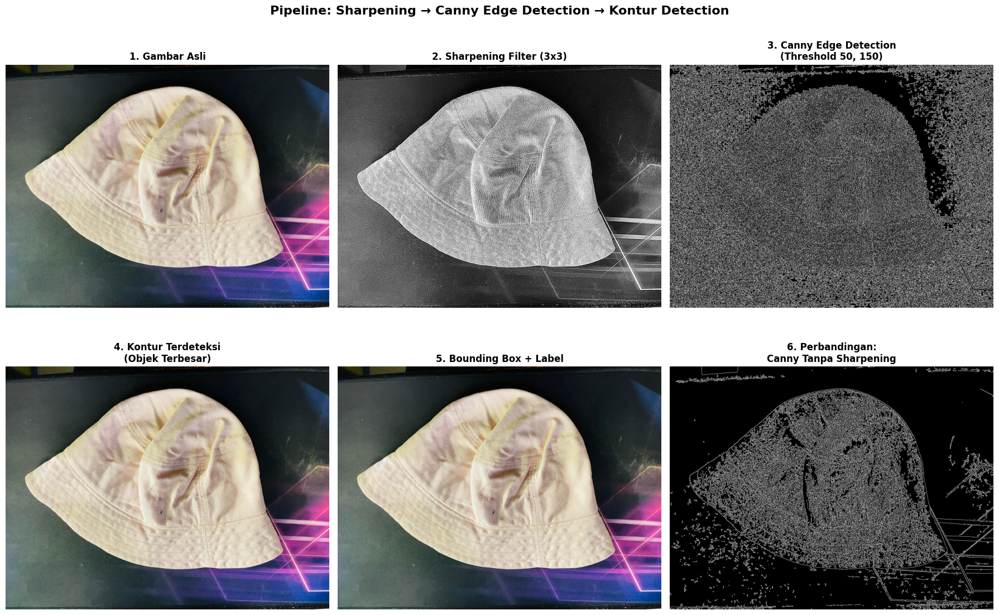


=== Perbandingan: Dengan Sharpening vs Tanpa Sharpening ===
Canny DENGAN Sharpening (50,150) : 381994 pixel
Canny TANPA Sharpening (50,150)  : 178412 pixel
Selisih                          : 203582 pixel


In [47]:
# ========================================
# FILTER SHARPENING + CANNY EDGE DETECTION + DETEKSI KONTUR
# ========================================

# Mengambil gambar objek dari assets_ws4
img_path = os.path.join(os.getcwd(), "assets_ws4", "topi.jpeg")
img = cv2.imread(img_path)

# Konversi ke RGB untuk ditampilkan dengan benar di matplotlib
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Konversi ke grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# ========================================
# 1. TERAPKAN FILTER SHARPENING (Penajaman)
# ========================================
# Kernel sharpening untuk meningkatkan detail tepi
kernel_sharpening = np.array([
    [-1, -1, -1],
    [-1,  9, -1],
    [-1, -1, -1]
])

# Terapkan sharpening filter
img_sharpened = cv2.filter2D(img_gray, -1, kernel_sharpening)

print("=== Tahap 1: Filter Sharpening ===")
print(f"Ukuran gambar: {img.shape}")
print(f"Kernel Sharpening: 3x3")
print(f"Kernel matrix:")
print(kernel_sharpening)

# ========================================
# 2. CANNY EDGE DETECTION (dengan sharpening)
# ========================================
# Threshold rendah (30, 90)
edges_sharp_low = cv2.Canny(img_sharpened, 30, 90)

# Threshold sedang (50, 150)
edges_sharp_medium = cv2.Canny(img_sharpened, 50, 150)

# Threshold tinggi (100, 200)
edges_sharp_high = cv2.Canny(img_sharpened, 100, 200)

print("\n=== Tahap 2: Canny Edge Detection (dengan Sharpening) ===")
print(f"Jumlah pixel tepi terdeteksi:")
print(f"  Threshold Rendah (30, 90)  : {np.count_nonzero(edges_sharp_low)} pixel")
print(f"  Threshold Sedang (50, 150) : {np.count_nonzero(edges_sharp_medium)} pixel")
print(f"  Threshold Tinggi (100, 200): {np.count_nonzero(edges_sharp_high)} pixel")

# ========================================
# 3. DETEKSI KONTUR (menggunakan threshold sedang)
# ========================================
contours_sharp, hierarchy_sharp = cv2.findContours(edges_sharp_medium, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter kontur dengan area minimum
min_area = 10000
filtered_contours_sharp = [c for c in contours_sharp if cv2.contourArea(c) > min_area]

# Ambil hanya kontur terbesar (TOPI)
if len(filtered_contours_sharp) > 0:
    largest_contour_sharp = max(filtered_contours_sharp, key=cv2.contourArea)
    topi_contours_sharp = [largest_contour_sharp]
else:
    topi_contours_sharp = []

print("\n=== Tahap 3: Deteksi Kontur ===")
print(f"Total kontur terdeteksi: {len(contours_sharp)}")
print(f"Kontur setelah filter (area > {min_area}px²): {len(filtered_contours_sharp)}")
print(f"Kontur TOPI terpilih: {len(topi_contours_sharp)}")

# Gambar kontur dan bounding box
img_contours_sharp = img.copy()
img_boxes_sharp = img.copy()

if len(topi_contours_sharp) > 0:
    # Gambar kontur (hijau)
    cv2.drawContours(img_contours_sharp, topi_contours_sharp, -1, (0, 255, 0), 5)
    
    # Gambar bounding box (merah)
    c = topi_contours_sharp[0]
    x, y, w, h = cv2.boundingRect(c)
    area = cv2.contourArea(c)
    
    color = (0, 0, 255)  # Merah
    thickness = 6
    
    cv2.rectangle(img_boxes_sharp, (x, y), (x + w, y + h), color, thickness)
    
    # Tambahkan label
    cv2.putText(img_boxes_sharp, "TOPI", (x, y-60), 
                cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 4)
    cv2.putText(img_boxes_sharp, f"Area: {area:.0f} px²", (x, y-35), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2)
    cv2.putText(img_boxes_sharp, f"Size: {w}x{h} px", (x, y-10), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)
    
    print(f"\n📦 Detail Objek TOPI:")
    print(f"  Area           : {area:.0f} px²")
    print(f"  Posisi (x,y)   : ({x}, {y})")
    print(f"  Ukuran (w×h)   : {w} × {h} px")
    perimeter = cv2.arcLength(c, True)
    print(f"  Keliling       : {perimeter:.0f} px")
    print(f"  Aspect Ratio   : {w/h:.2f}")

print("="*50)

# ========================================
# VISUALISASI HASIL (2 baris x 3 kolom)
# ========================================
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Baris 1: Tahap Preprocessing
axes[0, 0].imshow(img_rgb)
axes[0, 0].set_title('1. Gambar Asli', fontsize=12, fontweight='bold')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_sharpened, cmap='gray')
axes[0, 1].set_title('2. Sharpening Filter (3x3)', fontsize=12, fontweight='bold')
axes[0, 1].axis('off')

axes[0, 2].imshow(edges_sharp_medium, cmap='gray')
axes[0, 2].set_title('3. Canny Edge Detection\n(Threshold 50, 150)', fontsize=12, fontweight='bold')
axes[0, 2].axis('off')

# Baris 2: Hasil Deteksi Kontur
axes[1, 0].imshow(cv2.cvtColor(img_contours_sharp, cv2.COLOR_BGR2RGB))
axes[1, 0].set_title('4. Kontur Terdeteksi\n(Objek Terbesar)', fontsize=12, fontweight='bold')
axes[1, 0].axis('off')

axes[1, 1].imshow(cv2.cvtColor(img_boxes_sharp, cv2.COLOR_BGR2RGB))
axes[1, 1].set_title('5. Bounding Box + Label', fontsize=12, fontweight='bold')
axes[1, 1].axis('off')

# Perbandingan: Tanpa Sharpening vs Dengan Sharpening
edges_no_sharp = cv2.Canny(img_gray, 50, 150)
axes[1, 2].imshow(edges_no_sharp, cmap='gray')
axes[1, 2].set_title('6. Perbandingan:\nCanny Tanpa Sharpening', fontsize=12, fontweight='bold')
axes[1, 2].axis('off')

plt.suptitle('Pipeline: Sharpening → Canny Edge Detection → Kontur Detection', 
             fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

# Perbandingan jumlah pixel edge
print("\n=== Perbandingan: Dengan Sharpening vs Tanpa Sharpening ===")
print(f"Canny DENGAN Sharpening (50,150) : {np.count_nonzero(edges_sharp_medium)} pixel")
print(f"Canny TANPA Sharpening (50,150)  : {np.count_nonzero(edges_no_sharp)} pixel")
print(f"Selisih                          : {abs(np.count_nonzero(edges_sharp_medium) - np.count_nonzero(edges_no_sharp))} pixel")
print("="*50)

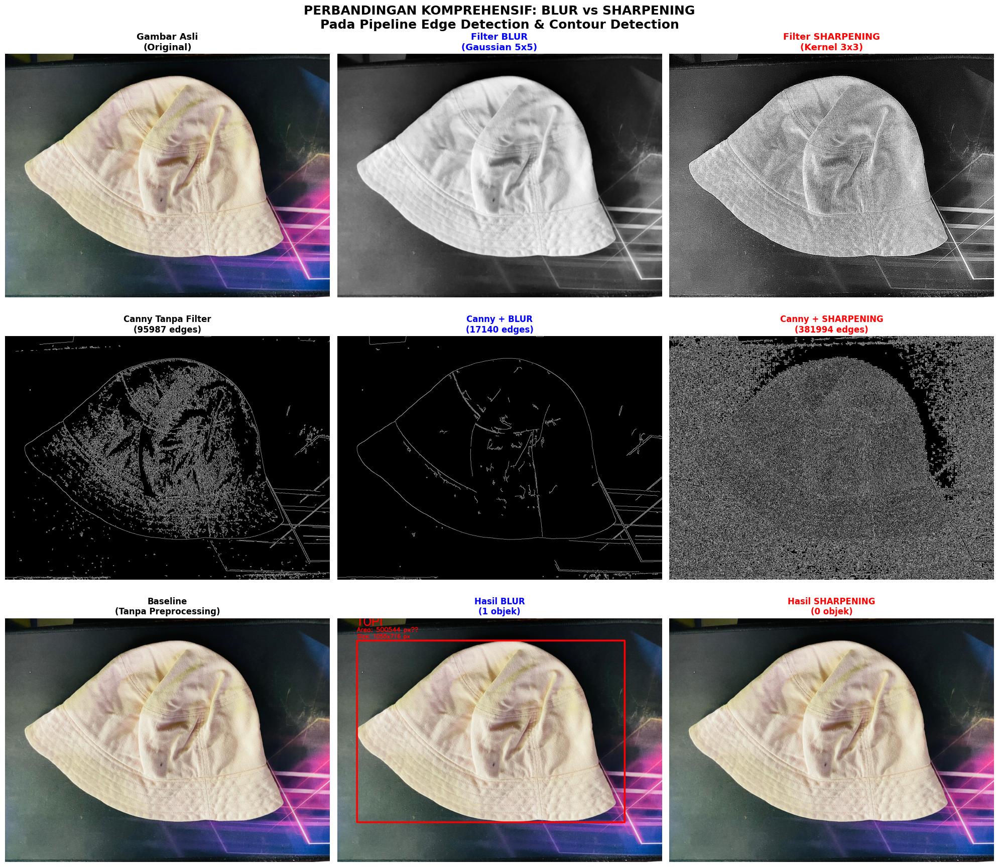

In [48]:
# ========================================
# VISUALISASI GRID PERBANDINGAN (3x3)
# ========================================
fig, axes = plt.subplots(3, 3, figsize=(20, 18))

# BARIS 1: PREPROCESSING
axes[0, 0].imshow(img_rgb)
axes[0, 0].set_title('Gambar Asli\n(Original)', fontsize=13, fontweight='bold')
axes[0, 0].axis('off')

axes[0, 1].imshow(img_blur, cmap='gray')
axes[0, 1].set_title('Filter BLUR\n(Gaussian 5x5)', fontsize=13, fontweight='bold', color='blue')
axes[0, 1].axis('off')

axes[0, 2].imshow(img_sharpened, cmap='gray')
axes[0, 2].set_title('Filter SHARPENING\n(Kernel 3x3)', fontsize=13, fontweight='bold', color='red')
axes[0, 2].axis('off')

# BARIS 2: EDGE DETECTION
axes[1, 0].imshow(edges_no_blur, cmap='gray')
axes[1, 0].set_title(f'Canny Tanpa Filter\n({np.count_nonzero(edges_no_blur)} edges)', 
                     fontsize=12, fontweight='bold')
axes[1, 0].axis('off')

axes[1, 1].imshow(edges_blur_medium, cmap='gray')
axes[1, 1].set_title(f'Canny + BLUR\n({np.count_nonzero(edges_blur_medium)} edges)', 
                     fontsize=12, fontweight='bold', color='blue')
axes[1, 1].axis('off')

axes[1, 2].imshow(edges_sharp_medium, cmap='gray')
axes[1, 2].set_title(f'Canny + SHARPENING\n({np.count_nonzero(edges_sharp_medium)} edges)', 
                     fontsize=12, fontweight='bold', color='red')
axes[1, 2].axis('off')

# BARIS 3: HASIL DETEKSI KONTUR + BOUNDING BOX
axes[2, 0].imshow(img_rgb)
axes[2, 0].set_title('Baseline\n(Tanpa Preprocessing)', fontsize=12, fontweight='bold')
axes[2, 0].axis('off')

axes[2, 1].imshow(cv2.cvtColor(img_boxes_blur, cv2.COLOR_BGR2RGB))
axes[2, 1].set_title(f'Hasil BLUR\n({len(topi_contours_blur)} objek)', 
                     fontsize=12, fontweight='bold', color='blue')
axes[2, 1].axis('off')

axes[2, 2].imshow(cv2.cvtColor(img_boxes_sharp, cv2.COLOR_BGR2RGB))
axes[2, 2].set_title(f'Hasil SHARPENING\n({len(topi_contours_sharp)} objek)', 
                     fontsize=12, fontweight='bold', color='red')
axes[2, 2].axis('off')

# Super title
plt.suptitle('PERBANDINGAN KOMPREHENSIF: BLUR vs SHARPENING\nPada Pipeline Edge Detection & Contour Detection', 
             fontsize=18, fontweight='bold', y=0.98)

plt.tight_layout()
plt.show()

Jelaskan bagaimana setiap filter memengaruhi detail gambar dalam format **Markdown**.

Dari hasil eksperimen yang telah dilakukan, filter **BLUR (Gaussian)** bekerja dengan cara menghaluskan gambar sehingga **mengurangi noise** pada background yang berantakan, membuat hasil edge detection lebih bersih dan kontur objek lebih stabil (seperti terlihat pada deteksi topi yang akurat), namun mengorbankan detail halus dan mengurangi jumlah tepi yang terdeteksi. Sebaliknya, filter **SHARPENING** mempertajam perbedaan antar pixel untuk **meningkatkan detail** dan membuat tekstur lebih jelas, sehingga Canny mendeteksi lebih banyak edge, tetapi noise pada background juga ikut diperkuat yang membuat kontur menjadi berantakan dengan banyak deteksi objek kecil yang tidak relevan. **Kesimpulannya**: gunakan **BLUR** kalau tujuannya segmentasi objek dengan background kompleks (fokus ke objek utama), dan gunakan **SHARPENING** kalau perlu mendeteksi detail halus atau gambar asli terlalu blur/gelap—keduanya punya trade-off antara stabilitas vs detail.

ada tips juga sih dari latihan" sebelumnya untuk threshold:
- Gambar ber-noise tinggi → gunakan threshold tinggi
- Butuh detail halus → gunakan threshold rendah
- Untuk deteksi kontur → pilih threshold sedang

### **Soal 4 — Deteksi Wajah dan Filter Digital Kreatif**

* Ambil gambar diri Anda dengan ekspresi wajah **netral**.
* Lakukan **deteksi wajah dan landmark** menggunakan salah satu dari:

  * **MediaPipe**, atau
  * **Dlib**, atau
  * **OpenCV**.
* Buat **overlay filter digital kreatif** karya Anda sendiri, misalnya:

  * topi, kumis, masker, helm, aksesoris, atau bentuk unik lainnya.
  * Filter boleh dibuat dari **gambar eksternal (PNG)** *atau* digambar langsung (misal bentuk lingkaran, garis, poligon, dll).
* Pastikan posisi overlay menyesuaikan **landmark wajah** dengan logis.
* **Gunakan alpha blending sebagai saran** agar hasil tampak lebih natural.
* Tampilkan perbandingan antara **gambar asli** dan **hasil dengan filter**.
* Jelaskan bagaimana Anda menghitung posisi overlay dan tantangan yang dihadapi selama implementasi (gunakan **Markdown**).

=== Deteksi Face Mesh dengan MediaPipe ===
✓ Wajah terdeteksi: 1 wajah


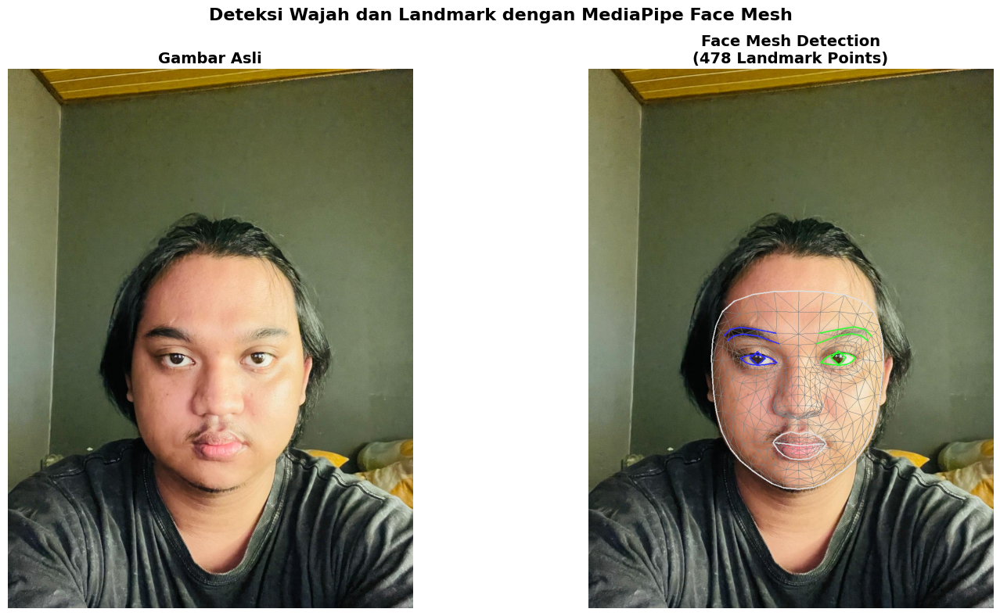

In [17]:
import cv2
import os
import matplotlib.pyplot as plt
import mediapipe as mp
import numpy as np

# Inisialisasi MediaPipe Face Mesh (untuk landmark detail)
mp_face_mesh = mp.solutions.face_mesh
mp_drawing = mp.solutions.drawing_utils
mp_drawing_styles = mp.solutions.drawing_styles

# Ambil gambar diri
img_path = os.path.join(os.getcwd(), "assets_ws4", "selfie.jpeg")
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Buat copy untuk visualisasi
img_with_landmarks = img_rgb.copy()

print("=== Deteksi Face Mesh dengan MediaPipe ===")

# Lakukan deteksi face mesh dengan mediapipe
with mp_face_mesh.FaceMesh(
    static_image_mode=True,
    max_num_faces=1,
    refine_landmarks=True,  # Menambahkan landmark iris untuk detail lebih
    min_detection_confidence=0.5
) as face_mesh:
    
    # Proses gambar
    results = face_mesh.process(img_rgb)
    
    if results.multi_face_landmarks:
        print(f"✓ Wajah terdeteksi: {len(results.multi_face_landmarks)} wajah")
        
        for face_landmarks in results.multi_face_landmarks:
            # Gambar tesselation (jaring wajah)
            mp_drawing.draw_landmarks(
                image=img_with_landmarks,
                landmark_list=face_landmarks,
                connections=mp_face_mesh.FACEMESH_TESSELATION,
                landmark_drawing_spec=None,
                connection_drawing_spec=mp_drawing_styles.get_default_face_mesh_tesselation_style()
            )
            
            # Gambar kontur wajah
            mp_drawing.draw_landmarks(
                image=img_with_landmarks,
                landmark_list=face_landmarks,
                connections=mp_face_mesh.FACEMESH_CONTOURS,
                landmark_drawing_spec=None,
                connection_drawing_spec=mp_drawing_styles.get_default_face_mesh_contours_style()
            )
            
            # Gambar iris (mata)
            mp_drawing.draw_landmarks(
                image=img_with_landmarks,
                landmark_list=face_landmarks,
                connections=mp_face_mesh.FACEMESH_IRISES,
                landmark_drawing_spec=None,
                connection_drawing_spec=mp_drawing_styles.get_default_face_mesh_iris_connections_style()
            )
        
        # Visualisasi perbandingan
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        
        # Gambar asli
        axes[0].imshow(img_rgb)
        axes[0].set_title('Gambar Asli', fontsize=14, fontweight='bold')
        axes[0].axis('off')
        
        # Gambar dengan face mesh
        axes[1].imshow(img_with_landmarks)
        axes[1].set_title(f'Face Mesh Detection\n({len(face_landmarks.landmark)} Landmark Points)', 
                         fontsize=14, fontweight='bold')
        axes[1].axis('off')
        
        plt.suptitle('Deteksi Wajah dan Landmark dengan MediaPipe Face Mesh', 
                     fontsize=16, fontweight='bold', y=0.98)
        plt.tight_layout()
        plt.show()
        
    else:
        print("❌ Wajah tidak terdeteksi dalam gambar.")
        print("Coba gunakan gambar dengan wajah yang lebih jelas atau ubah min_detection_confidence.")

=== Menambahkan Overlay Filter Digital Kacamata ===
Ukuran kacamata asli: (353, 707, 4)

✓ Overlay kacamata berhasil ditambahkan!


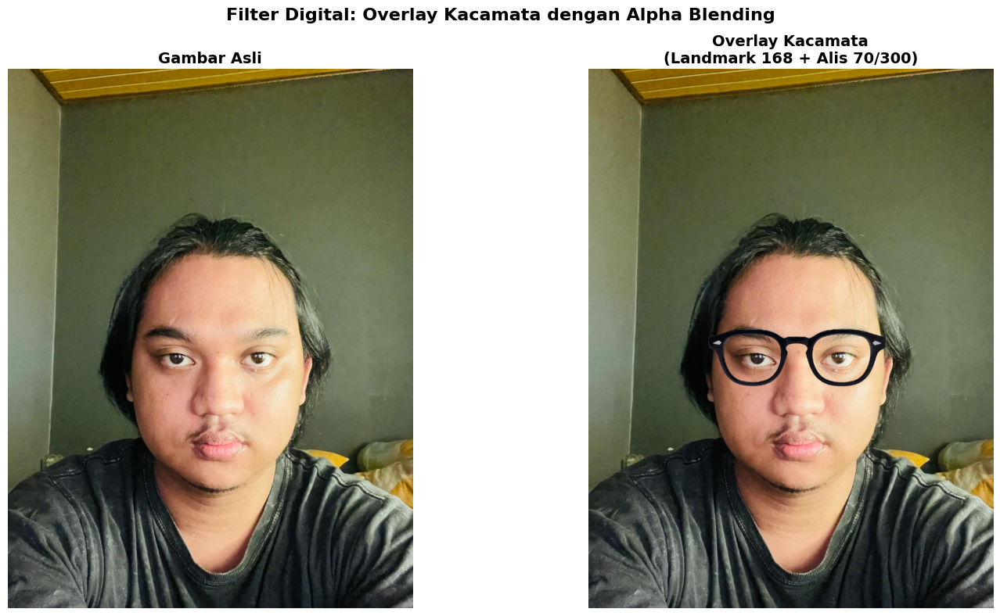

In [18]:
import cv2
import os
import matplotlib.pyplot as plt
import mediapipe as mp
import numpy as np

# Inisialisasi MediaPipe Face Mesh
mp_face_mesh = mp.solutions.face_mesh

# Load gambar selfie
img_path = os.path.join(os.getcwd(), "assets_ws4", "selfie.jpeg")
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Load gambar kacamata (dengan alpha channel)
glass_path = os.path.join(os.getcwd(), "assets_ws4", "kcmta.png")
glass_img = cv2.imread(glass_path, cv2.IMREAD_UNCHANGED)

# Konversi kacamata ke RGBA
if glass_img.shape[2] == 4:
    glass_rgba = cv2.cvtColor(glass_img, cv2.COLOR_BGRA2RGBA)
elif glass_img.shape[2] == 3:
    # Tambah alpha channel jika tidak ada
    glass_rgb = cv2.cvtColor(glass_img, cv2.COLOR_BGR2RGB)
    alpha_channel = np.ones((glass_rgb.shape[0], glass_rgb.shape[1]), dtype=glass_rgb.dtype) * 255
    glass_rgba = np.dstack((glass_rgb, alpha_channel))

print("=== Menambahkan Overlay Filter Digital Kacamata ===")
print(f"Ukuran kacamata asli: {glass_rgba.shape}")

# Deteksi wajah dan landmark
with mp_face_mesh.FaceMesh(
    static_image_mode=True,
    max_num_faces=1,
    refine_landmarks=True,
    min_detection_confidence=0.5
) as face_mesh:
    
    results = face_mesh.process(img_rgb)
    
    if results.multi_face_landmarks:
        for face_landmarks in results.multi_face_landmarks:
            ih, iw, _ = img_rgb.shape
            
            # Ambil landmark penting
            nose_bridge = face_landmarks.landmark[168]    # Bridge hidung
            left_eyebrow = face_landmarks.landmark[70]    # Alis kiri
            right_eyebrow = face_landmarks.landmark[300]  # Alis kanan
            
            # Hitung jarak antar alis untuk menentukan ukuran kacamata
            eyebrow_distance = int(np.sqrt(
                ((right_eyebrow.x - left_eyebrow.x) * iw) ** 2 +
                ((right_eyebrow.y - left_eyebrow.y) * ih) ** 2
            ))
            
            # Scale factor: 1.3x dari jarak alis (bisa disesuaikan: 0.9-1.5)
            scale_factor = (eyebrow_distance * 1.3) / glass_rgba.shape[1]
            
            # Resize kacamata sesuai ukuran wajah
            glass_w = int(glass_rgba.shape[1] * scale_factor)
            glass_h = int(glass_rgba.shape[0] * scale_factor)
            glass_resized = cv2.resize(glass_rgba, (glass_w, glass_h))
            
            # Hitung posisi kacamata (center di landmark 168)
            center_x = int(nose_bridge.x * iw)
            center_y = int(nose_bridge.y * ih)
            top_left_x = center_x - glass_w // 2
            top_left_y = center_y - glass_h // 2
            
            # Extract alpha channel dan RGB
            glass_alpha = glass_resized[:, :, 3] / 255.0
            glass_rgb_channel = glass_resized[:, :, :3]
            
            
            # Alpha blending untuk overlay kacamata
            for y in range(glass_h):
                for x in range(glass_w):
                    img_y = top_left_y + y
                    img_x = top_left_x + x
                    
                    # Pastikan koordinat dalam bounds gambar
                    if 0 <= img_y < ih and 0 <= img_x < iw:
                        alpha = glass_alpha[y, x]
                        # Formula alpha blending: hasil = alpha*foreground + (1-alpha)*background
                        img_rgb[img_y, img_x] = (
                            alpha * glass_rgb_channel[y, x] +
                            (1 - alpha) * img_rgb[img_y, img_x]
                        ).astype(np.uint8)
        
        print("\n✓ Overlay kacamata berhasil ditambahkan!")
        print("="*60)
        
        # Visualisasi perbandingan
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        
        # Load gambar asli untuk perbandingan
        img_original = cv2.imread(img_path)
        img_original_rgb = cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB)
        
        # Gambar asli
        axes[0].imshow(img_original_rgb)
        axes[0].set_title('Gambar Asli', fontsize=14, fontweight='bold')
        axes[0].axis('off')
        
        # Gambar dengan overlay kacamata
        axes[1].imshow(img_rgb)
        axes[1].set_title('Overlay Kacamata\n(Landmark 168 + Alis 70/300)', 
                         fontsize=14, fontweight='bold')
        axes[1].axis('off')
        
        plt.suptitle('Filter Digital: Overlay Kacamata dengan Alpha Blending', 
                     fontsize=16, fontweight='bold', y=0.98)
        plt.tight_layout()
        plt.show()
        
    else:
        print("❌ Wajah tidak terdeteksi dalam gambar.")

Saya menggunakan MediaPipe untuk mendeteksi wajah, lalu ambil 3 titik penting: landmark 168 di tengah hidung (untuk posisi kacamata), landmark 70 di alis kiri, dan landmark 300 di alis kanan. Cara kerjanya seperti ini: pertama hitung jarak antara alis kiri dan kanan untuk tahu seberapa lebar wajah, lalu ukuran kacamata disesuaikan 1.3x dari jarak itu supaya pas. Posisi kacamata ditaruh di tengah hidung (landmark 168), koordinatnya diubah dari angka 0-1 ke pixel asli gambar dengan cara dikalikan lebar gambar. Setelah dapat titik tengah, hitung posisi kiri atas kacamata supaya pas di tengah. Untuk nempel kacamatanya, saya pakai alpha blending yang cara kerjanya mirip photoshop: bagian transparan kacamata bakal kelihatan background dibaliknya, bagian solid bakal nutupin wajah sepenuhnya. Tantangannya adalah kadang kacamata bisa keluar dari batas gambar kalau wajah di pinggir, jadi saya cek dulu setiap pixel sebelum ditempel biar gak error.

### **Soal 5 — Perspektif dan Peningkatan Kualitas Citra**

* Ambil gambar **objek datar** seperti karya tangan di kertas, tulisan di papan tulis, atau foto produk di meja dengan kondisi pencahayaan atau sudut yang tidak ideal.
* Lakukan **preprocessing** untuk memperbaiki tampilan agar lebih rapi dan jelas, dengan langkah-langkah:

  * Konversi ke **grayscale**.
  * **Koreksi perspektif (transformasi homografi)** menggunakan **4 titik manual** agar objek terlihat sejajar dan tidak terdistorsi.
  * Terapkan **thresholding adaptif atau Otsu** (pilih salah satu, dan jelaskan alasan pilihan Anda).
* Tampilkan **setiap tahap pemrosesan dalam satu grid** agar mudah dibandingkan.
* Jelaskan fungsi masing-masing tahap dan bagaimana teknik ini meningkatkan kualitas visual citra (gunakan **Markdown**).

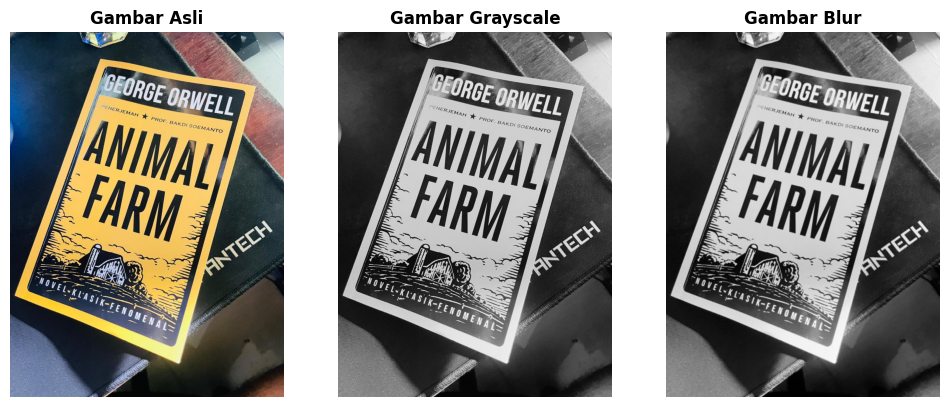

In [47]:
# Mengambil gambar objek dari assets_ws4
img_path = os.path.join(os.getcwd(), "assets_ws4", "buku.jpeg") 
img = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Konversi ke grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Blur dulu untuk kurangi noise
img_blur = cv2.GaussianBlur(img_gray, (5, 5), 0)

# Menampilkan gambar
fig, axes = plt.subplots(1,3, figsize=(12, 10))
axes[0].imshow(img_rgb)
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')
axes[1].imshow(img_gray, cmap='gray')
axes[1].set_title('Gambar Grayscale', fontsize=12, fontweight='bold')
axes[1].axis('off')
axes[2].imshow(img_blur, cmap='gray')
axes[2].set_title('Gambar Blur', fontsize=12, fontweight='bold')
axes[2].axis('off')
plt.show()



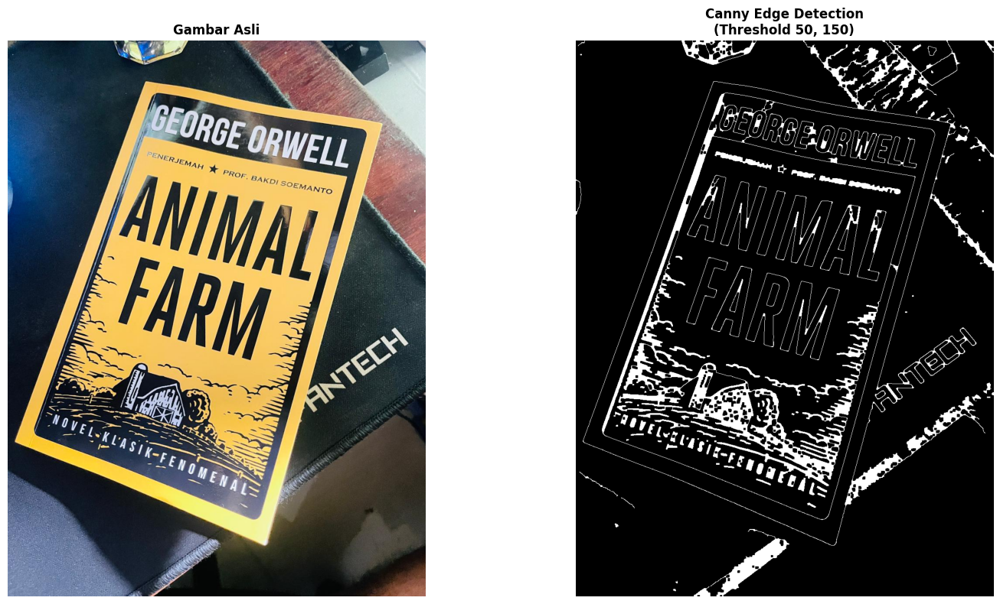

In [50]:
# Terapkan Canny Edge Detection
edges = cv2.Canny(img_blur, 50, 150)

# Morfologi - Dilation untuk mempertebal tepi
kernel = np.ones((5,5), np.uint8)
edges = cv2.dilate(edges, kernel, iterations=1)
edges = cv2.erode(edges, kernel, iterations=1)

# Visualisasi hasil edge detection
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(img_rgb)
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')
axes[1].imshow(edges, cmap='gray')
axes[1].set_title('Canny Edge Detection\n(Threshold 50, 150)', fontsize=12, fontweight='bold')
axes[1].axis('off')
plt.tight_layout()
plt.show()

Kontur ditemukan - Area: 581134, Titik: 5
Kontur ditemukan - Area: 552546, Titik: 4


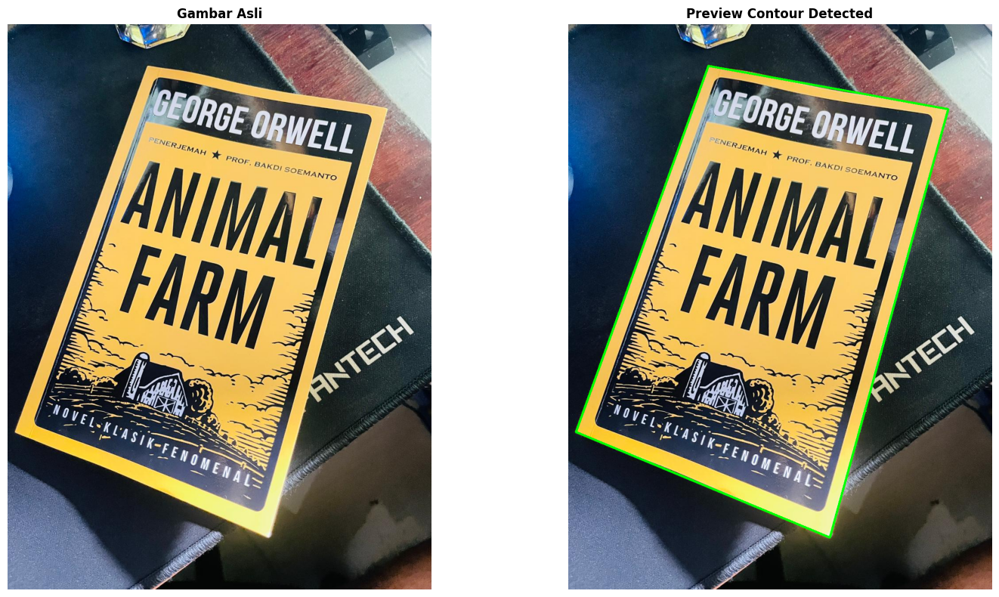

In [51]:
# Find Contours
contours, _ = cv2.findContours(edges.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]

# Cari titik sudut 
document_contour = None

for c in contours:
    peri = cv2.arcLength(c, True)
    area = cv2.contourArea(c)
    
    # PERBAIKAN 5: Area minimum lebih besar
    if area < 10000:
        continue
    
    # Titik aproksimasi dengan epsilon lebih fleksibel
    approx = cv2.approxPolyDP(c, 0.03 * peri, True)
    
    print(f"Kontur ditemukan - Area: {area:.0f}, Titik: {len(approx)}")
    
    if len(approx) == 4:
        document_contour = approx
        break
    
# Preview Contour
img_contour = img.copy()
cv2.drawContours(img_contour, [document_contour], -1, (0, 255, 0), 3)
fig, axes = plt.subplots(1, 2, figsize=(16, 8))
axes[0].imshow(img_rgb)
axes[0].set_title('Gambar Asli', fontsize=12, fontweight='bold')
axes[0].axis('off')
axes[1].imshow(cv2.cvtColor(img_contour, cv2.COLOR_BGR2RGB))
axes[1].set_title('Preview Contour Detected', fontsize=12, fontweight='bold')
axes[1].axis('off')
plt.tight_layout()
plt.show()


=== Tahap 4: Transformasi Perspektif ===
Original Image size: (1280, 960, 3)
Document corners: [[ 317.   94.]
 [ 860.  192.]
 [ 592. 1162.]
 [  17.  923.]]
Dimensi hasil transform: 622 x 1006 px
Destination points:
[[   0.    0.]
 [ 621.    0.]
 [ 621. 1005.]
 [   0. 1005.]]

✓ Transformasi perspektif berhasil!


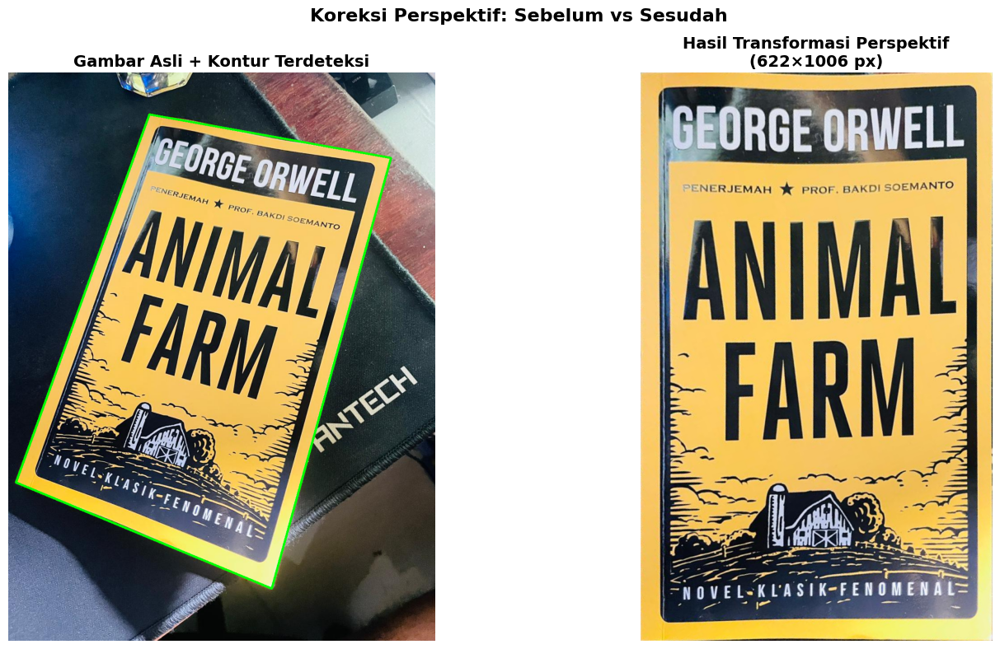


✓ Gambar hasil transformasi disimpan di: c:\DATA\KULIYEAH\2025\Multimedia\Memo-Multimedia\results_ws4\buku_warped.jpg


In [ ]:
# TRANSFORMASI PERSPEKTIF
if document_contour is not None:
    print("=== Tahap 4: Transformasi Perspektif ===")
    
    # Reshape kontur jadi 4 titik (x, y)
    pts = document_contour.reshape(4, 2)
    
    # Inisialisasi array untuk titik sudut
    rect = np.zeros((4, 2), dtype="float32")
    
    # Tentukan urutan titik: [top-left, top-right, bottom-right, bottom-left]
    s = pts.sum(axis=1)
    rect[0] = pts[np.argmin(s)]  # kiri atas (sum terkecil)
    rect[2] = pts[np.argmax(s)]  # kanan bawah (sum terbesar)
    
    diff = np.diff(pts, axis=1)
    rect[1] = pts[np.argmin(diff)]  # kanan atas (diff terkecil)
    rect[3] = pts[np.argmax(diff)]  # kiri bawah (diff terbesar)
    
    print(f"Original Image size: {img.shape}")
    print(f"Document corners: {rect}")
    
    # Hitung dimensi buku hasil transform
    tl, tr, br, bl = rect
    
    # Hitung lebar (ambil yang terpanjang)
    widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
    widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
    maxWidth = max(int(widthA), int(widthB))
    
    # Hitung tinggi (ambil yang terpanjang)
    heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
    heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
    maxHeight = max(int(heightA), int(heightB))
    
    print(f"Dimensi hasil transform: {maxWidth} x {maxHeight} px")
    
    # Titik tujuan (top-down view rectangle)
    dst = np.array([
        [0, 0],                           # kiri atas
        [maxWidth - 1, 0],                # kanan atas
        [maxWidth - 1, maxHeight - 1],    # kanan bawah
        [0, maxHeight - 1]                # kiri bawah
    ], dtype="float32")
    
    print(f"Destination points:\n{dst}")
    
    # Hitung matrix transformasi perspektif
    M = cv2.getPerspectiveTransform(rect, dst)
    
    # Terapkan transformasi
    warped = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    warped_rgb = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)
    
    print("\n✓ Transformasi perspektif berhasil!")
    print("="*60)
    
    # VISUALISASI HASIL
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Gambar asli dengan kontur
    axes[0].imshow(cv2.cvtColor(img_contour, cv2.COLOR_BGR2RGB))
    axes[0].set_title('Gambar Asli + Kontur Terdeteksi', fontsize=14, fontweight='bold')
    axes[0].axis('off')
    
    # Hasil transformasi (top-down view)
    axes[1].imshow(warped_rgb)
    axes[1].set_title(f'Hasil Transformasi Perspektif\n({maxWidth}×{maxHeight} px)', 
                     fontsize=14, fontweight='bold')
    axes[1].axis('off')
    
    plt.suptitle('Koreksi Perspektif: Sebelum vs Sesudah', 
                 fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()
    
    # Simpan hasil
    output_dir = os.path.join(os.getcwd(), "results_ws4")
    os.makedirs(output_dir, exist_ok=True)
    output_path = os.path.join(output_dir, "buku_warped.jpg")
    cv2.imwrite(output_path, warped)
    print(f"\n✓ Gambar hasil transformasi disimpan di: {output_path}")
    
else:
    print(" Kontur tidak ditemukan, tidak bisa melakukan transformasi perspektif.")


Pipeline koreksi perspektif dokumen ini bekerja secara bertahap: pertama **grayscale** untuk menyederhanakan data menjadi 1 channel intensitas, lalu **Gaussian Blur** menghilangkan noise agar edge detection lebih akurat. **Canny Edge Detection** mendeteksi tepi objek berdasarkan gradien intensitas, diperkuat dengan **morphological operations** (dilate-erode) untuk menutup gap dan memperjelas kontur. Selanjutnya **contour detection** mencari bentuk tertutup dengan 4 sudut (dokumen), titik-titiknya diurutkan menggunakan operasi matematis `sum()` dan `diff()` untuk mendapatkan posisi top-left, top-right, bottom-right, bottom-left yang benar. Terakhir, **perspective transform** memetakan 4 titik sudut dokumen yang miring ke bentuk rectangle sempurna menggunakan homography matrix, menghasilkan gambar "top-down view" yang lurus seperti hasil scan. Setiap tahap saling melengkapi untuk mengubah foto dokumen miring menjadi scan digital yang rapi.

### **Aturan Umum Pengerjaan**

* Kerjakan secara **mandiri**.
* Bantuan AI (seperti ChatGPT, Copilot, dsb.) diperbolehkan **dengan bukti percakapan** (screenshot / link / script percakapan).
* Source code antar mahasiswa harus berbeda.
* Jika mendapat bantuan teman, tuliskan nama dan NIM teman yang membantu.
* Plagiarisme akan dikenakan sanksi sesuai aturan akademik ITERA.
* Cantumkan seluruh **credit dan referensi** yang digunakan di bagian akhir notebook.
* Penjelasan setiap soal ditulis dalam **Markdown**, bukan di dalam komentar kode.

---

### **Aturan Pengumpulan**

* Semua file kerja Anda (notebook `.ipynb`, gambar, dan hasil) **wajib diunggah ke GitHub repository tugas sebelumnya**.

  * Gunakan struktur folder berikut di dalam repo Anda:

    ```
    /Nama_NIM_Repo/ # Nama repo sebelumnya
      ├── assets_ws4/     # berisi semua gambar atau video asli (input)
      ├── results_ws4/    # berisi semua hasil modifikasi dan output
      ├── worksheet4.ipynb
      └── NIM_Worksheet4.pdf
    ```
* File yang dikumpulkan ke **Tally** hanya berupa **hasil PDF** dari notebook Anda, dengan format nama:

  ```
  NIM_Worksheet4.pdf
  ```
* Pastikan notebook telah dijalankan penuh sebelum diekspor ke PDF.
* Sertakan tautan ke repository GitHub Anda di bagian atas notebook atau di halaman pertama PDF.

---

### ✅ **Catatan Akhir**

> Worksheet 4 ini bertujuan mengasah pemahaman Anda tentang manipulasi citra digital secara praktis. Gunakan kreativitas Anda untuk menghasilkan hasil visual yang menarik dan penjelasan konseptual yang jelas.

### **Credit**

* Materi Perkuliahan Image Processing - [IF25-40305](https://github.com/informatika-itera/IF25-40305-handson/tree/main) 
* Landmark Face - [AI Google](https://ai.google.dev/edge/mediapipe/solutions/vision/face_landmarker?hl=id)
* Gambar Kacamata > Remove BG [Pngegg](https://www.pngegg.com/id/png-mukty)
* Percakapan AI - [Copilot ](https://drive.google.com/drive/folders/1MAEIga_JyJeYWH16-yCczCaTsJVgs3HR?usp=sharing)